/Users/sherryyang/anaconda3/envs/omnipose-track/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


new shape:  (2187, 2619)
2024-01-10 19:43:11,926 [INFO] ** TORCH GPU version installed and working. **
>>> GPU activated? True
2024-01-10 19:43:11,927 [INFO] >>bact_phase_omni<< model set to be used
2024-01-10 19:43:11,928 [INFO] ** TORCH GPU version installed and working. **
2024-01-10 19:43:11,928 [INFO] >>>> using GPU
2024-01-10 19:43:12,076 [INFO] Evaluating with flow_threshold 0.00, mask_threshold 0.00
2024-01-10 19:43:12,076 [INFO] using omni model, cluster True
2024-01-10 19:43:12,076 [INFO] using dataparallel
2024-01-10 19:43:12,134 [INFO] shape before transforms.convert_image(): (2187, 2619)
2024-01-10 19:43:12,166 [INFO] shape after transforms.convert_image(): (2187, 2619, 2)
2024-01-10 19:43:12,166 [INFO] shape now (1, 2187, 2619, 2)
2024-01-10 19:43:22,689 [INFO] mask_threshold is 0.000000
2024-01-10 19:43:22,692 [INFO] Using hysteresis threshold.
2024-01-10 19:43:22,960 [INFO] niter is 22
2024-01-10 19:43:23,116 [INFO] Mean diameter is 22.240452
2024-01-10 19:43:23,133 [IN

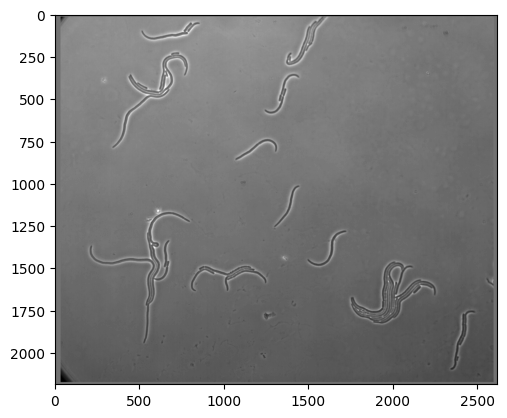

In [1]:
import hierarchy
import segementation
from pathlib import Path
import os
from cellpose_omni import io
import omnipose

#file = "/Users/sherryyang/Documents/wiggins-lab/data/1024/xy5/phase/2016-06-16_zstack007t134xy5c1.tif"
file = "/Users/sherryyang/Documents/wiggins-lab/data/1027/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00023xy0c1.tif"
#file = "/Users/sherryyang/Documents/wiggins-lab/data/1021/raw_im/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00023xy0c1.tif"


from cellpose_omni import io, transforms
from omnipose.utils import normalize99
img = io.imread(file)


import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

img = transforms.move_min_dim(img) # move the channel dimension last
if len(img.shape)>2:
    # imgs[k] = img[:,:,1] # could pick out a specific channel
    img = np.mean(img,axis=-1) # or just turn into grayscale 
    
img = normalize99(img)
# imgs[k] = np.pad(imgs[k],10,'edge')
print('new shape: ', img.shape)
plt.imshow(img,cmap='gray')


from cellpose_omni import models
from cellpose_omni.models import MODEL_NAMES


# Import dependencies
import numpy as np
from cellpose_omni import models, core

# This checks to see if you have set up your GPU properly.
# CPU performance is a lot slower, but not a problem if you 
# are only processing a few images.
use_GPU = core.use_gpu()
print('>>> GPU activated? {}'.format(use_GPU))

# for plotting
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rcParams['figure.dpi'] = 300
plt.style.use('dark_background')


model_name = 'bact_phase_omni'
model = models.CellposeModel(gpu=use_GPU, model_type=model_name)


import os
os.environ['PYTORCH_MPS_HIGH_WATERMARK_RATIO'] = '0.0'  # Adjust the ratio as needed


params = {
    'channels' : [0, 0], 
    'mask_threshold': 0.0, 
    'flow_threshold': 0.0, 
    'diameter': 0.0, 
    'invert': False, 
    'cluster': True, 
    'net_avg': False, 
    'do_3D': False, 
    'omni': True,
    'verbose':True,
}

masks, flows, styles = model.eval(img,**params)
[RGB_dP, dP, cellprob, p, bd, tr, affinity, bounds] = flows
dP = dP.squeeze()
cellprob = cellprob.squeeze()


In [31]:
from skimage import filters, measure

iscell = filters.apply_hysteresis_threshold(cellprob, 0 - 1, 0) 
coords = np.array(np.nonzero(iscell)).T.astype(np.int32)
shape = cellprob.shape

In [3]:
def cluster(shape, coords):

    EPS = 2 ** 0.5
    MIN_SAMPLES = 5

    cood_num = coords.shape[0]
    labels = -1 * np.ones(cood_num)
    mask = np.full(shape, None, dtype=object)
    for c_index in range(cood_num):
        x, y = map(int, coords[c_index])
        if mask[x,y] is None: 
            mask[x, y] = set()
        mask[x, y].add(c_index)
    queue = []
    label = 0
    for c_index in range(cood_num):
        if labels[c_index] == -1 : queue.append(c_index)
        while queue:
            x, y = map(int, coords[queue.pop()])
            delta = int(1 + EPS)
            neighbors = set().union(*mask[x-delta:x+delta, y-delta:y+delta].flatten())
            close_neighbors = set()
            for coord in neighbors:
                if np.sqrt(( x- coord[0]) ** 2 + (y - coord[1]) ** 2) <= EPS: 
                    close_neighbors.add(coord)

            if close_neighbors > MIN_SAMPLES:
                queue.extend(close_neighbors)

            labels[c_index] = label

        label += 1

    return labels

        

In [4]:
from collections import deque

EPS = 2 ** 0.5
MIN_SAMPLES = 5

coord_num = coords.shape[0]
labels = -1 * np.ones(coord_num)
mask = np.full(shape, None, dtype=object)
for c_index in range(coord_num):
    x, y = map(int, coords[c_index])
    if mask[x][y] is None:
        mask[x][y] = set()
    mask[x, y].add(c_index)

queue = deque()
label = 0
for c_index in range(coord_num):
    #print(f"c_index{c_index}")
    if labels[c_index] == -1 : queue.append(c_index)
    while queue:
        current_c = queue.popleft()
        #print(f"current_c{current_c}")
        x, y = map(int, coords[current_c])
        delta = int(1 + EPS)
        #neighbors = set().union(*mask[x-delta:x+delta, y-delta:y+delta].flatten())
        neighbors = set().union(*[mask[i, j] for i in range(x-delta, x+delta) for j in range(y-delta, y+delta) if mask[i, j] is not None])
        #print(neighbors)
        close_neighbors = set()
        for c_index in neighbors:
            #print((x- coords[c_index][0]) ** 2 + (y - coords[c_index][1]) ** 2)
            if np.sqrt((x- coords[c_index][0]) ** 2 + (y - coords[c_index][1]) ** 2) <= EPS: 
                close_neighbors.add(c_index)

        if len(close_neighbors) > MIN_SAMPLES:
            close_neighbors.remove(current_c)
            #print(queue)
            #print([i for i in close_neighbors if (labels[c_index] == -1 and i not in queue)])
            queue.extend([i for i in close_neighbors if (labels[c_index] == -1 and i not in queue)])
            
        labels[current_c] = label

    label += 1

KeyboardInterrupt: 

In [95]:
 labels = [labeled_mask[int(coord[0])][int(coord[1])] for coord in sub_coords]

In [96]:
labels

[1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,


In [67]:
from collections import deque

EPS = 2 ** 0.5
MIN_SAMPLES = 5

coord_num = coords.shape[0]
labels = -1 * np.ones(coord_num)
mask = np.full(shape, None, dtype=object)
for c_index in range(coord_num):
    x, y = map(int, coords[c_index])
    if mask[x][y] is None:
        mask[x][y] = set()
    mask[x, y].add(c_index)

interested = set()
label = 0
for hyper_index in range(coord_num):
    if labels[hyper_index] == -1 : interested = {hyper_index}
    while interested:
        next_interested = set()
        for c in interested:
            x, y = map(int, coords[c])
            delta = int(1 + EPS)
            neighbors = set().union(*[mask[i, j] for i in range(x-delta, x+delta) for j in range(y-delta, y+delta) if mask[i, j] is not None])
            close_neighbors = set()
            for c_index in neighbors:
                if np.sqrt((x- coords[c_index][0]) ** 2 + (y - coords[c_index][1]) ** 2) <= EPS: 
                    close_neighbors.add(c_index)
            if len(close_neighbors) > MIN_SAMPLES:
                next_interested.update([i for i in close_neighbors if (labels[c] == -1 and (i not in interested))])
            
            labels[c] = label

        interested = next_interested

    label += 1

6.9141387939453125e-06
6.9141387939453125e-06
4.0531158447265625e-06
3.0994415283203125e-06
2.1457672119140625e-06
3.0994415283203125e-06
3.0994415283203125e-06
2.86102294921875e-06
3.0994415283203125e-06
2.1457672119140625e-06
2.1457672119140625e-06
2.86102294921875e-06
2.86102294921875e-06
4.0531158447265625e-06
2.86102294921875e-06
2.86102294921875e-06
3.0994415283203125e-06
3.0994415283203125e-06
2.86102294921875e-06
3.0994415283203125e-06
4.291534423828125e-06
2.86102294921875e-06
2.86102294921875e-06
3.0994415283203125e-06
3.0994415283203125e-06
2.6226043701171875e-06
3.0994415283203125e-06
2.86102294921875e-06
3.0994415283203125e-06
1.9073486328125e-06
3.814697265625e-06
3.0994415283203125e-06
3.0994415283203125e-06
3.0994415283203125e-06
3.0994415283203125e-06
3.0994415283203125e-06
1.9073486328125e-06
5.0067901611328125e-06
3.814697265625e-06
2.86102294921875e-06
3.0994415283203125e-06
3.0994415283203125e-06
3.0994415283203125e-06
3.0994415283203125e-06
3.0994415283203125e-06


KeyboardInterrupt: 

In [65]:
EPS

1.4142135623730951

In [61]:
for hyper_index in range(coord_num):
    x, y = map(int, coords[hyper_index])
    delta = int(1 + EPS)
    neighbors = set().union(*[mask[i, j] for i in range(x-delta, x+delta) for j in range(y-delta, y+delta) if mask[i, j] is not None])
    

TypeError: 'numpy.float64' object is not iterable

In [74]:
mask = np.array([[0,1,0], [1,1,1], [0,0,0]])
labeled_mask, num_features = measure.label(mask, connectivity=1, return_num=True)

In [82]:
MIN_MASK_SZIE = 15

sub_coords = coords

mask = np.zeros(shape)
mask[sub_coords.astype(int)] = 1
labeled_mask, num_features = measure.label(mask , connectivity=1, return_num=True)
labels = [labeled_mask[int(coord[0])][int(coord[1])] for coord in sub_coords]


In [85]:
mask = np.zeros(shape).T
mask[sub_coords.astype(int)] = 1

In [120]:
labels = np.array([1,2,3,4,5])

In [121]:
labels == 1

array([ True, False, False, False, False])

In [117]:
indices_with_label = np.where(labels == 1)

/var/folders/tp/1bsthy355yj6qlmh5ym1996w0000gn/T/ipykernel_62274/1708899882.py:1: DeprecationWarning: Calling nonzero on 0d arrays is deprecated, as it behaves surprisingly. Use `atleast_1d(cond).nonzero()` if the old behavior was intended. If the context of this warning is of the form `arr[nonzero(cond)]`, just use `arr[cond]`.
  indices_with_label = np.where(labels == 1)


In [118]:
indices_with_label

(array([], dtype=int64),)

In [108]:
labels[indices_with_label[0]]

IndexError: index 0 is out of bounds for axis 0 with size 0

In [59]:
from sklearn.cluster import DBSCAN


EPS = 2 ** 0.5
MIN_SAMPLES = 5
MIN_MASK_SZIE = 15
dbscan = DBSCAN(eps=EPS, min_samples=MIN_SAMPLES) 



db = dbscan.fit(coords)
labels = db.labels_

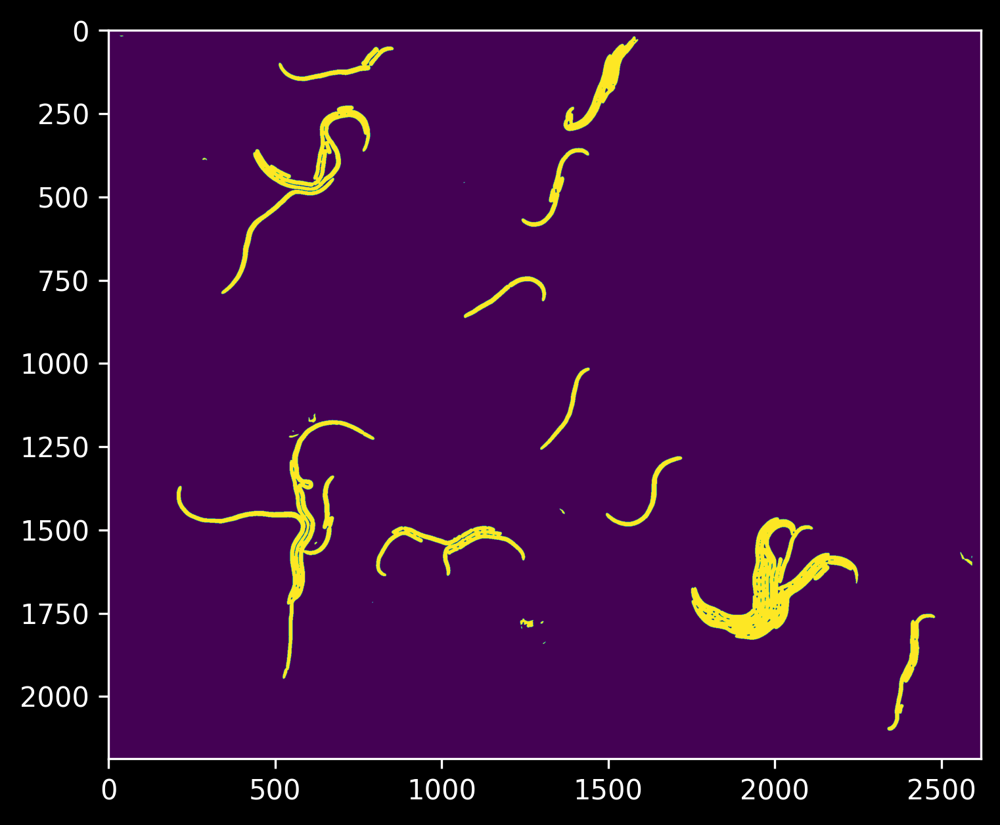

In [33]:
plt.imshow(iscell)

In [40]:
coords[11010]

array([141, 545], dtype=int32)

In [43]:
mask = np.zeros(shape)

In [44]:
mask

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [55]:
mask = np.zeros(shape)
for i in range(len(coords)):
    mask[coords[i][0]][coords[i][1]] = labels[i]

In [70]:
from sklearn.cluster import OPTICS
import numpy as np

# Generate sample data (replace this with your own data)
np.random.seed(0)
X = np.random.rand(100, 2) * 10

# Use the OPTICS clustering algorithm
clustering = OPTICS(min_samples=5, xi=0.05, min_cluster_size=0.1)

# Fit the model and predict the clusters
labels = clustering.fit_predict(coords)

KeyboardInterrupt: 

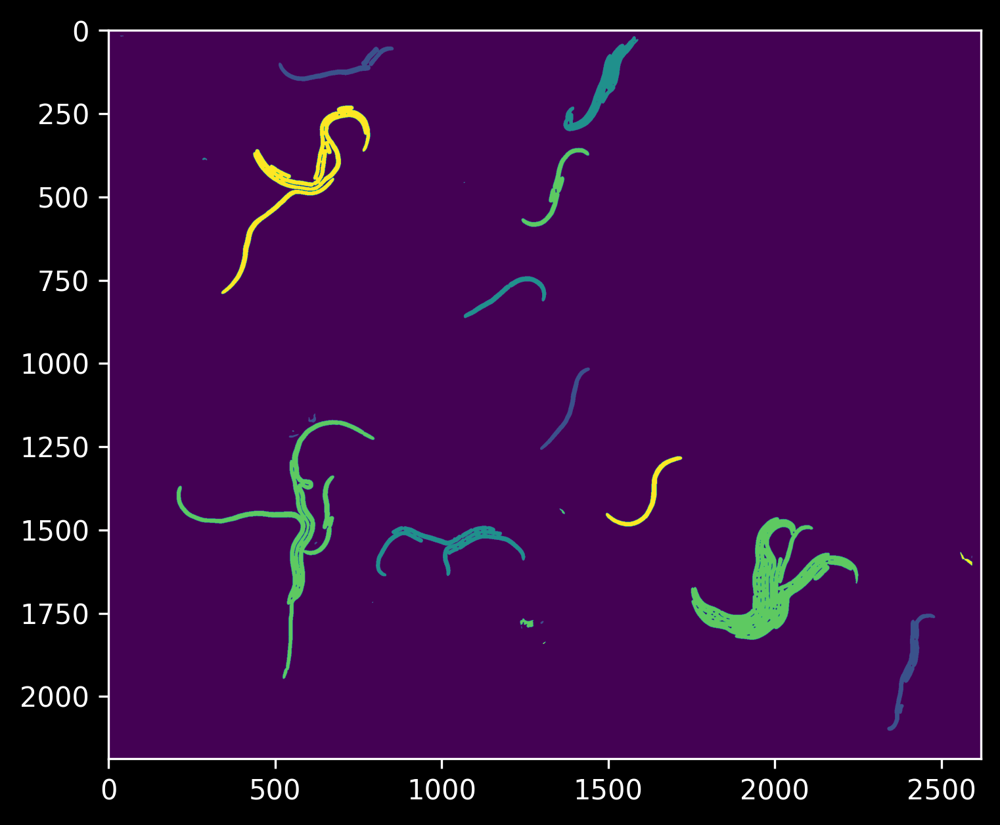

In [58]:
import matplotlib.pyplot as plt
import ncolor 
mask_n = ncolor.label(mask)
plt.imshow(mask_n)

In [12]:
labels[450]

244.0

In [6]:
coord_num

173381

In [118]:
4 not in queue

False

In [116]:
queue

deque([10, 2, 3, 4, 5, 6, 7, 8, 9, 17])

In [113]:
queue.append(3)

In [111]:
queue.pop()

3

In [109]:
queue.extend([c_index for c_index in close_neighbors if (labels[c_index] == -1 and c_index not in queue)])


In [93]:
a = {1,2}
a.remove([1,2])

TypeError: unhashable type: 'list'

In [92]:
label

3

In [80]:
cood_num

173381

In [79]:
mask[x-delta:x+delta, y-delta:y+delta]

array([[{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 2

In [73]:
queue = []
queue.append(3)
queue.pop()
queue

[]

In [74]:
queue == True

False

In [68]:
a = {1,2.3}
len(a)

2

In [63]:
*mask[1:100, 2:200].flatten()

SyntaxError: can't use starred expression here (435917708.py, line 1)

In [56]:
cluster(shape, coords)

TypeError: 'NoneType' object is not iterable

In [51]:
mask = np.empty((2,2), dtype=np.int64)
mask[1,1] 

4637651390029003424

In [ ]:
mask = np.full((2, 2), None, dtype=object)

In [14]:
int(2 * (2 + 1) * np.m( cellprob[cellprob > 0] ))

57

In [8]:
np.abs(cellprob[cellprob > 1])

array([1.0026813, 1.2611595, 1.8842218, ..., 1.9447494, 1.7428865,
       1.4676702], dtype=float32)

In [12]:
int(np.max(cellprob[cellprob > 0]))

9

In [25]:
np.unique(np.concatenate((np.linspace(1, 10, 3), np.linspace(10, 30, 3)))).astype(int)

array([ 1,  5, 10, 20, 30])

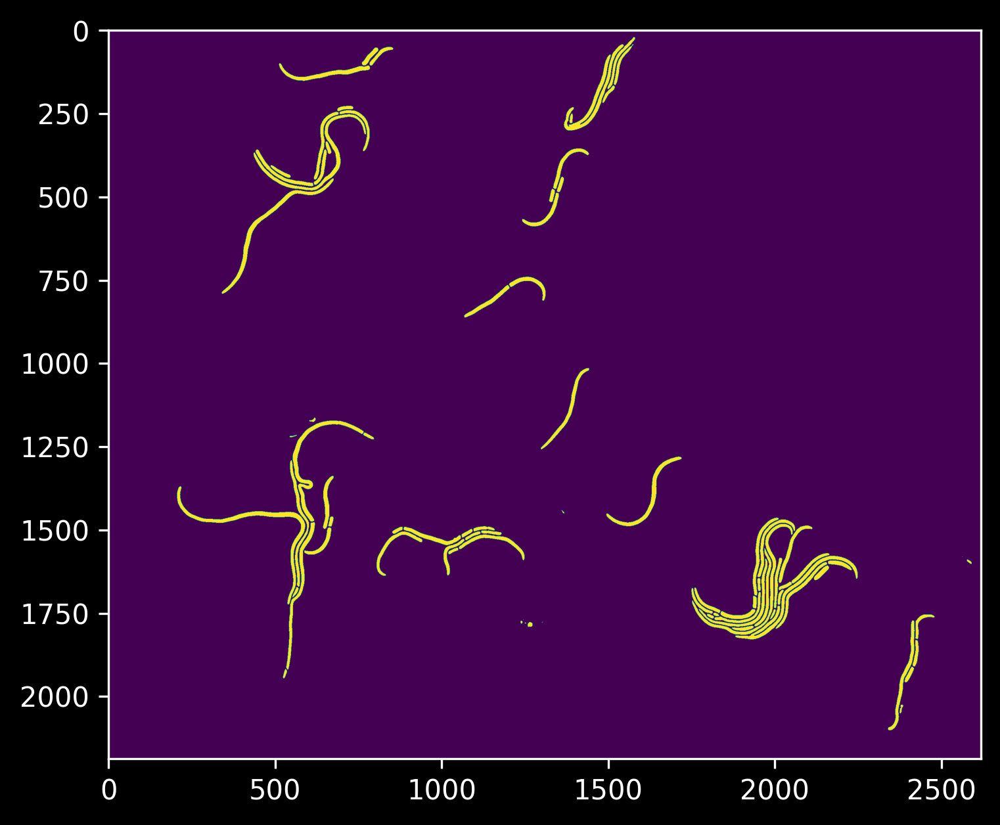

In [12]:
plt.imshow(cellprob > 2)

In [28]:
np.ceil(np.max(cellprob))

10.0

In [13]:
from skimage import measure
labeled_mask, num_features = measure.label(cellprob > 2, connectivity=1, return_num=True)

In [14]:
num_features 

84

In [16]:
hier = segementation.computer_hierarchy(cellprob, dP)

TypeError: Invalid shape (1067,) for image data

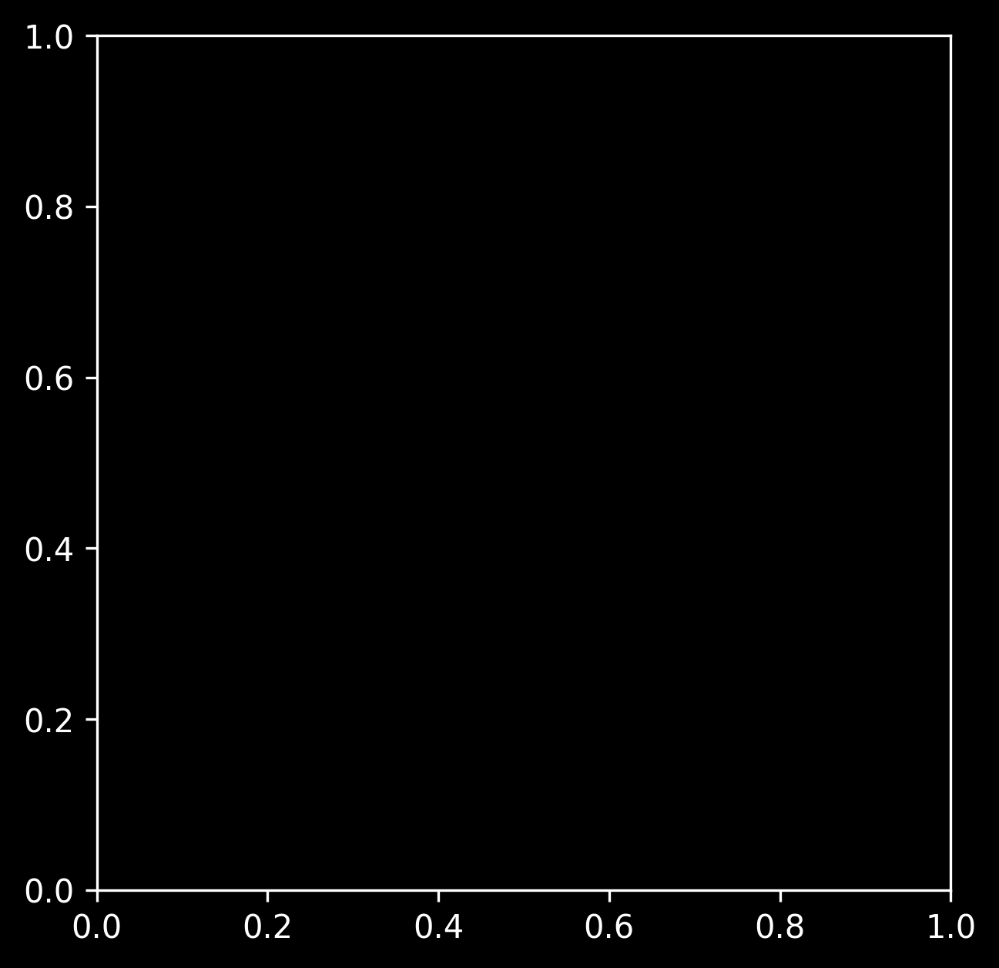

In [18]:
for node in hier.all_nodes():
    sub_coords = hier.root.value[np.array(node.value)]
    prop_mask = c > 1
    labeled_mask, num_features = measure.label(prop_mask , connectivity=1, return_num=True)

    plt.imshow(prop_mask)
    plt.show()
    print(num_features)

In [23]:
modified_cellprob = np.zeros(cellprob.shape)
modified_cellprob[sub_coords[:, 0], sub_coords[:, 1]] = 1

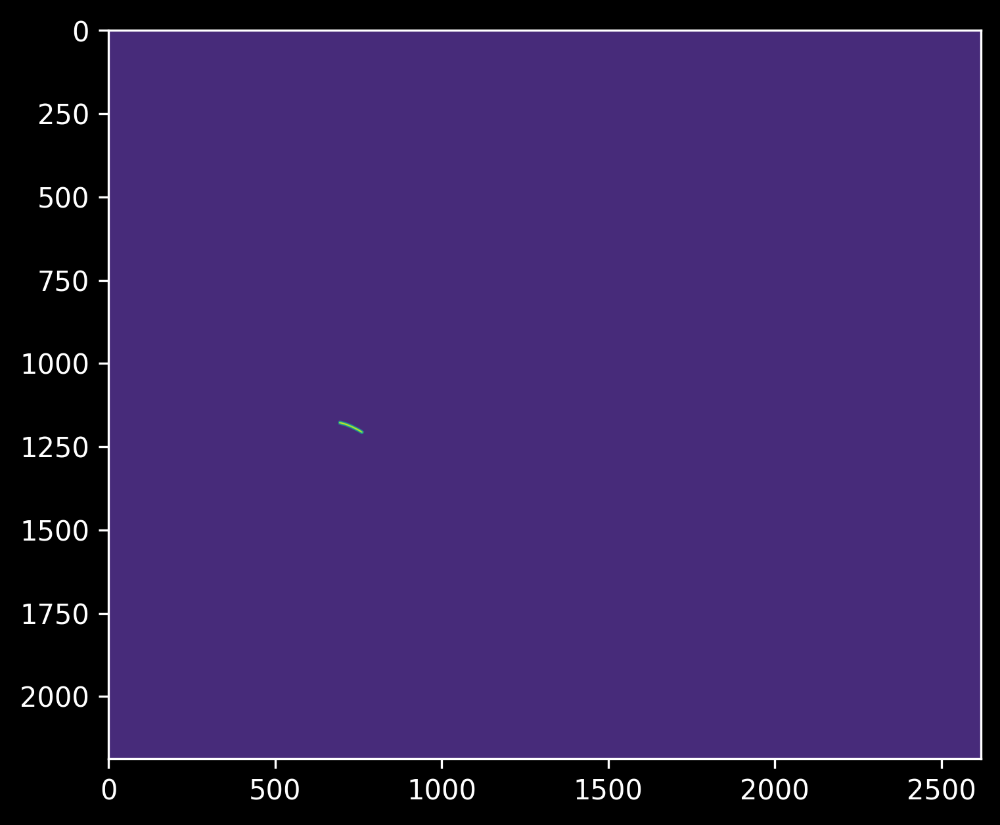

In [25]:
plt.imshow(modified_cellprob * cellprob)

In [28]:
mask = np.array([[set([1]), set([2, 3]), set([4])],
                 [set([5]), set([6, 7]), set([8])],
                 [set([9]), set([10, 11]), set([12])]])


# Merge or union all sets in the 1D array
merged_set = set().union(*mask.flatten())

In [30]:
1 != 1

False

In [29]:
merged_set

{1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12}

In [20]:
cellprob[sub_coords[:, 0], sub_coords[:, 1]] 

array([-0.10730255,  0.31232285,  0.8042443 , ...,  1.2523763 ,
       -0.8952799 ,  0.15640497], dtype=float32)

In [ ]:
cellprob[[], sub_coords[:, 1]] 

In [3]:
cell_px = tuple(coords.T)
labels = np.zeros(len(coords[:,0]))

In [4]:
mask = np.zeros(cellprob.shape)
mask[cell_px] = labels

In [5]:
leaves = hier.find_leaves()

In [6]:
i = 1
for l in leaves:
    labels[np.array(l.value)] = i
    i += 1

In [7]:
mask[cell_px] = labels

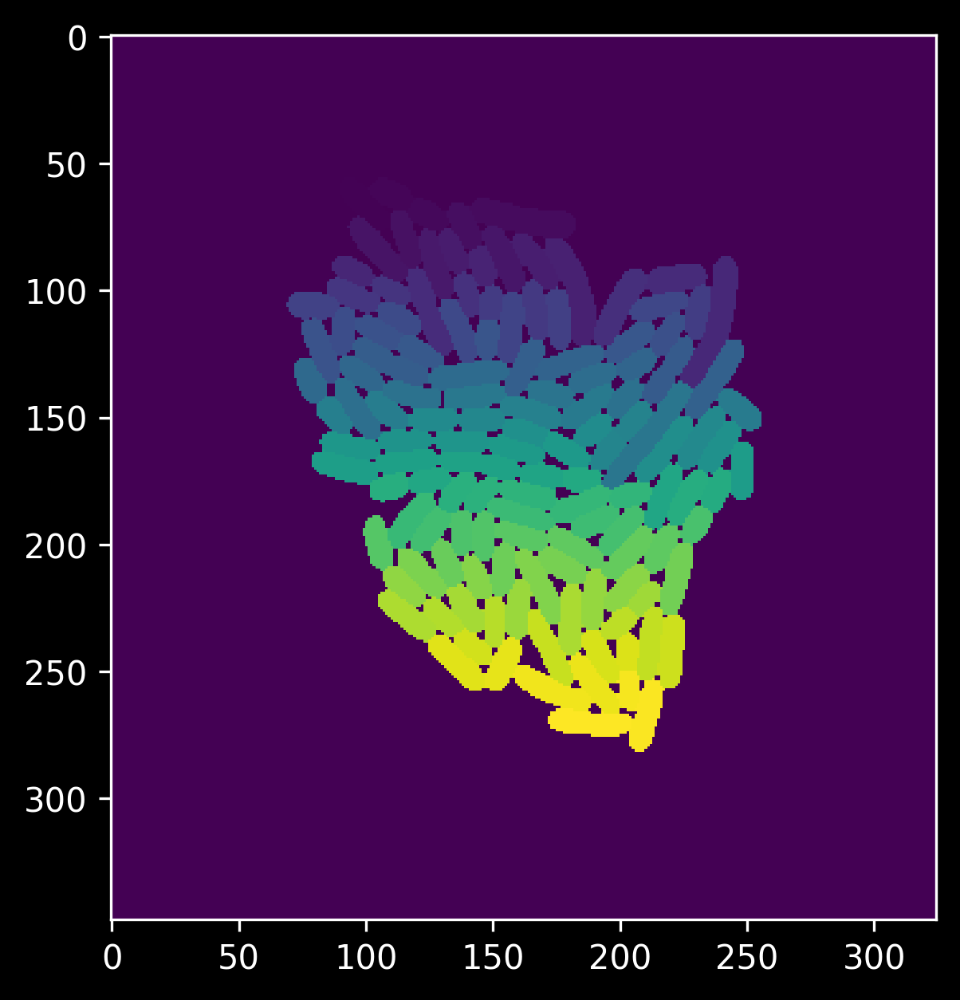

In [9]:
plt.imshow(mask)

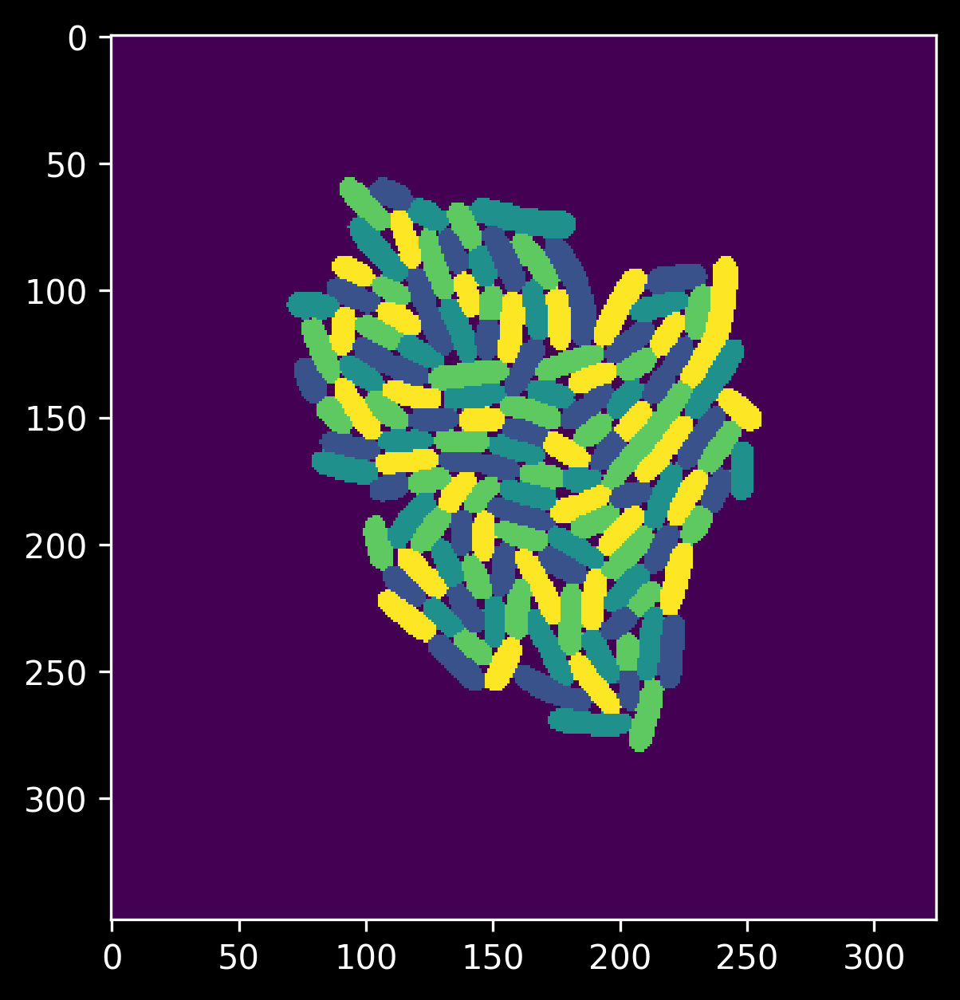

In [10]:
import ncolor
ncolor_masks = ncolor.label(mask)
plt.imshow(ncolor_masks)

In [ ]:
labels.shape

In [ ]:
len(arr)

In [ ]:
type(l.value)

In [ ]:
labels[(1,2,3)]

In [ ]:
np.unique([1,2,5,5,5,5])

In [ ]:
l = [1,2,3,4,5, -1]
np.unique(l)

In [ ]:
np.unique(l) >= 0

In [12]:
from core import process
process("/Users/sherryyang/Documents/wiggins-lab/data/1024/xy5/phase")

ImportError: cannot import name 'process' from 'core' (/Users/sherryyang/Projects/trackdemo/core.py)

In [ ]:
    from tracking import solve
    solve(hier_arr, seg_num = total_num, cost_func_name = "overlap")